In [1]:
import torch
import torchvision
import os
import random

/home/ubuntu/anaconda3/envs/cs231n/lib/python3.9/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
class TSintel(torchvision.datasets.Sintel):
    def __init__(self, root):
        super().__init__(root=root)
        
    def __getitem__(self, index):
        img1, img2, flow = super().__getitem__(index)
        img1 = torchvision.transforms.ToTensor()(img1)
        img2 = torchvision.transforms.ToTensor()(img2)
        return img1, img2, flow

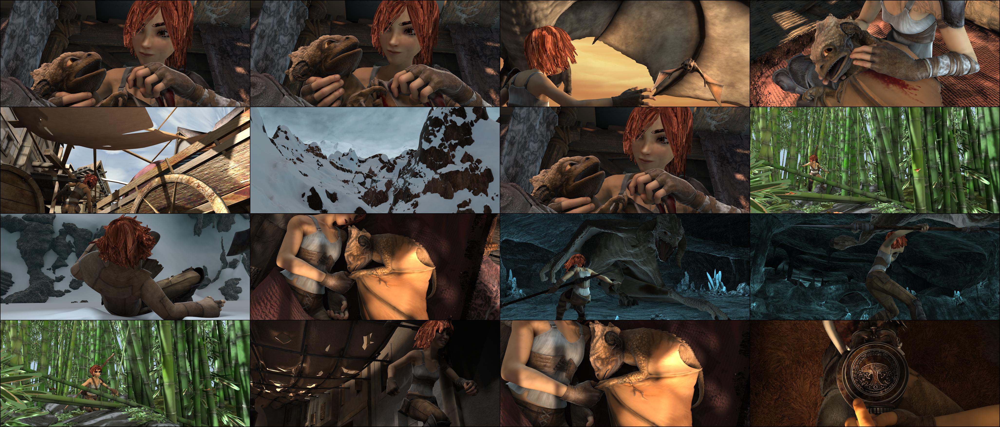

In [3]:
Tdata = TSintel(".")
indices = random.sample(range(1000), 16)
sampler = [Tdata[i][0] for i in indices]
grid = torchvision.utils.make_grid(sampler, nrow=4)
img = torchvision.transforms.ToPILImage()(grid)
img.show()

In [6]:
class TKitti(torchvision.datasets.KittiFlow):
    def __init__(self, root):
        super().__init__(root=root)
        
    def __getitem__(self, index):
        img1, img2, flow, valid_flow_mask = super().__getitem__(index)
        img1 = torchvision.transforms.ToTensor()(img1)
        img2 = torchvision.transforms.ToTensor()(img2)
        return img1, img2, flow, valid_flow_mask

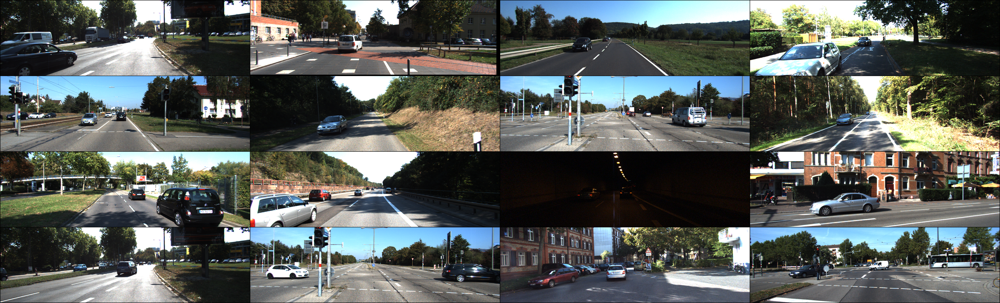

In [7]:
kitti = TKitti("./Kitti")
indices = random.sample(range(200), 16)
sampler = [torchvision.transforms.functional.crop(kitti[i][0], 0, 0, 375, 1241) for i in indices]
grid = torchvision.utils.make_grid(sampler, nrow=4)
img = torchvision.transforms.ToPILImage()(grid)
img.show()

In [10]:
class TFlyingChairs(torchvision.datasets.FlyingChairs):
    def __init__(self, root):
        super().__init__(root=root)
        
    def __getitem__(self, index):
        items = super().__getitem__(index)
        mask = None
        if len(items) == 4:
            img1, img2, flow, mask = items
        else:
            img1, img2, flow = items
        img1 = torchvision.transforms.ToTensor()(img1)
        img2 = torchvision.transforms.ToTensor()(img2)
        return img1, img2, flow, mask

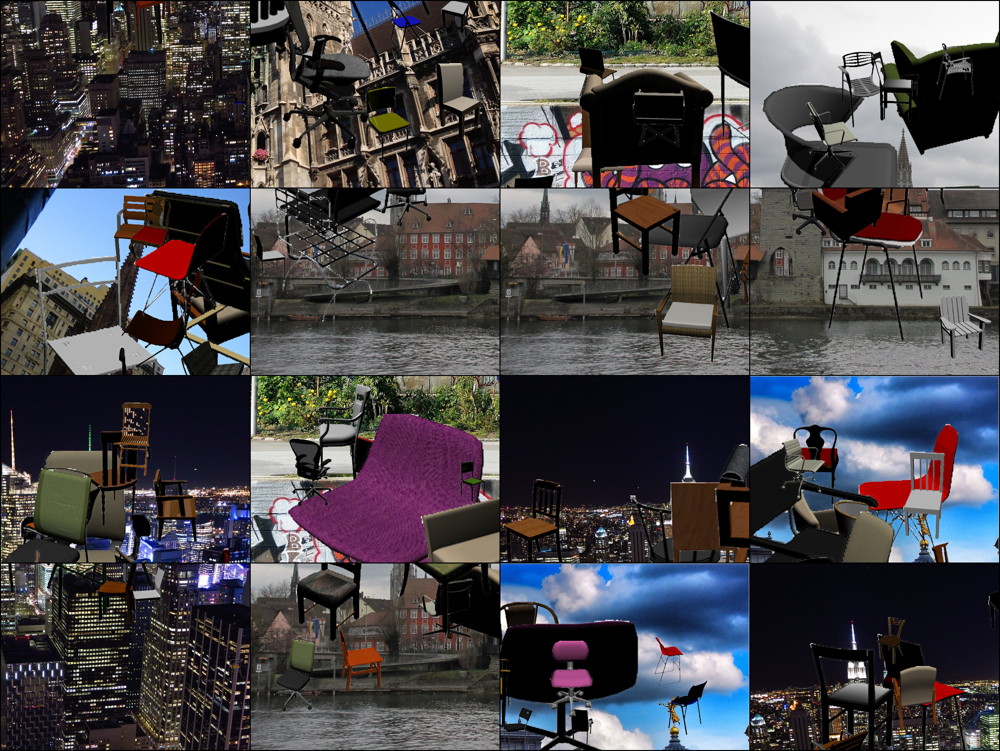

In [11]:
flyingChairs = TFlyingChairs("../FlyingChairs")
sampler = [flyingChairs[i][0] for i in indices]
grid = torchvision.utils.make_grid(sampler, nrow=4)
img = torchvision.transforms.ToPILImage()(grid)
img.show()